<a href="https://colab.research.google.com/github/mohansaidhanekula/Personalized-website/blob/main/MINIPROJECT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Install required labraries

In [ ]:
!pip install imbalanced-learn xgboost
import pandas as pd
import time
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import LabelEncoder, StandardScaler, PolynomialFeatures
from sklearn.model_selection import train_test_split
from sklearn.ensemble import StackingClassifier
from xgboost import XGBClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.metrics import accuracy_score, classification_report

Load the DATASET

In [ ]:
df = pd.read_csv('/content/Crop_recommendationV2_augmented_3x.csv')
categorical_cols = df.select_dtypes(include=['object']).columns
for col in categorical_cols:
    df[col] = LabelEncoder().fit_transform(df[col])

Model training and evaluation

In [ ]:
# Feature engineering
df = df.drop(columns=['label', 'soil_type', 'growth_stage', 'water_source_type',
                     'urban_area_proximity'], errors='ignore')
df['fertilizer_usage_class'] = pd.qcut(df['fertilizer_usage'], 3, labels=['Low', 'Medium', 'High'])

# assigning attributes
X = df.drop(columns=['fertilizer_usage', 'fertilizer_usage_class'])
X_poly = PolynomialFeatures(degree=2, interaction_only=True).fit_transform(X)
X_scaled = StandardScaler().fit_transform(X_poly)
y = df['fertilizer_usage_class']

# Balancing the dataset
smote = SMOTE(sampling_strategy={cls: len(y)//3 for cls in ['Low', 'Medium', 'High']}, random_state=42)
X_res, y_res = smote.fit_resample(X_scaled, y)

# Spliting the data
X_train, X_test, y_train, y_test = train_test_split(X_res, y_res, test_size=0.2, random_state=42)

# stacking model
start_time = time.time()
stacking_model = StackingClassifier(
    estimators=[
        ('rf', RandomForestClassifier(n_estimators=800, max_depth=30)),
        ('gb', GradientBoostingClassifier(n_estimators=800, learning_rate=0.03)),
        ('xgb', XGBClassifier(n_estimators=800, learning_rate=0.03)),
        ('ada', AdaBoostClassifier(n_estimators=800, learning_rate=0.05))
    ],
    final_estimator=LogisticRegression(max_iter=2000),
    n_jobs=-1
)

stacking_model.fit(X_train, y_train)
y_pred = stacking_model.predict(X_test)
runtime = time.time() - start_time

# Results
print(f"Final Stacking Model Accuracy: {accuracy_score(y_test, y_pred)*100:.2f}%")
print(f"Runtime: {runtime:.2f} seconds")
print("Classification Report:\n", classification_report(y_test, y_pred))

/usr/local/lib/python3.11/dist-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Final Stacking Model Accuracy: 94.17%
Runtime: 4385.84 seconds
Classification Report:
               precision    recall  f1-score   support

        High       0.93      0.95      0.94       430
         Low       0.96      0.94      0.95       450
      Medium       0.94      0.93      0.93       440

    accuracy                           0.94      1320
   macro avg       0.94      0.94      0.94      1320
weighted avg       0.94      0.94      0.94      1320



DATA VISUALIZATION

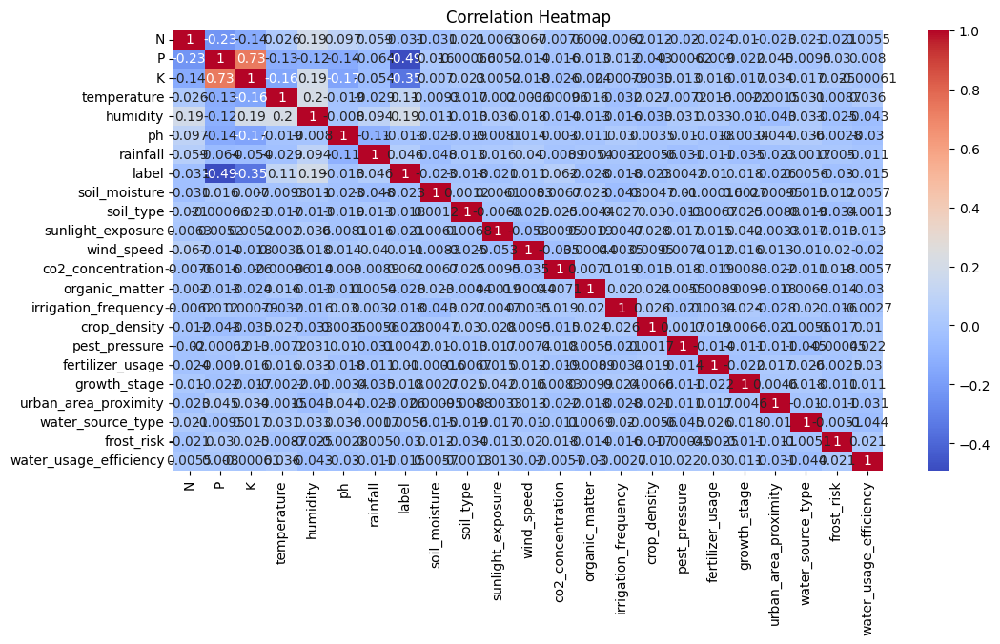

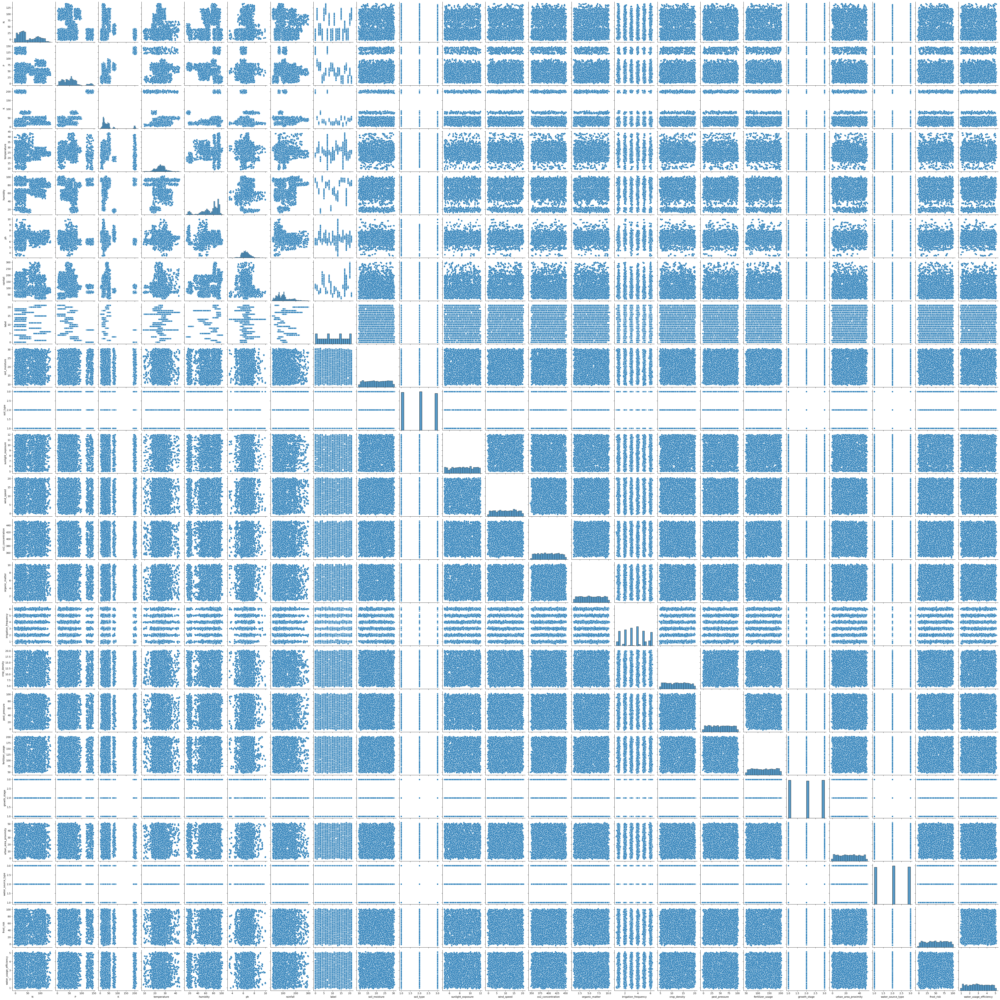

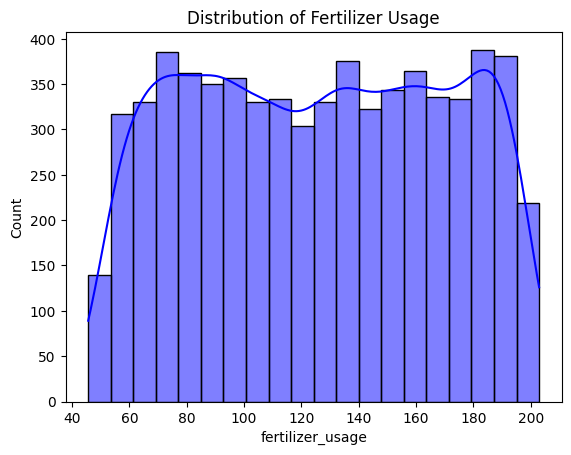

In [ ]:
plt.figure(figsize=(12,6))
# Coorelation heatmap
numerical_df = df.select_dtypes(include=['number'])
sns.heatmap(numerical_df.corr(), annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()
#Pair plots
sns.pairplot(df)
plt.show()
#Distribution Plot
sns.histplot(df['fertilizer_usage'], kde=True, color='blue')
plt.title('Distribution of Fertilizer Usage')
plt.show()